# Download the Sentienl images

In [1]:
# !pip install geopandas
# !pip install planetary_computer
# !pip install odc-stac
# !pip install rioxarray
# !pip install shapely
# !pip install Basemap

Sentinel data download flow diagram: 

![alt text](sentinel_data_download_process.png)

In [1]:
import pandas as pd
import numpy as np

import planetary_computer as pc

import pystac_client
from pystac_client import Client

from pystac.extensions.eo import EOExtension as eo
from odc.stac import stac_load, configure_rio

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

import rioxarray

import rasterio
import rasterio.plot
from rasterio.mask import mask
import math
import rioxarray
from shapely.geometry import Point, box

from shapely.geometry import Point, Polygon


import numpy as np
from PIL import Image
import torch
from torchvision import transforms

import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm import tqdm

/opt/anaconda3/envs/rishabh_space/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Function definations:

In [2]:
# Zoom level is 17
def project(lat,long):
    lat = np.radians(lat)
    long = np.radians(long)
    x = (128/np.pi)*(2**17)*(long + np.pi)
    y = (128/np.pi)*(2**17)*(np.pi - np.log(np.tan(np.pi/4 + lat/2)))
    return x,y

def inverse_project(x,y):
    F  = 128 / np.pi * 2 ** 17
    lng = (x / F) - np.pi
    lat = (2 * np.arctan(np.exp(np.pi - y/F)) - np.pi / 2)
    lng = lng * 180 / np.pi
    lat = lat * 180 / np.pi
    return lat, lng

In [3]:
def get_aoi_mod(latitude, longitude):
    height = 1120
    width = 1120

    # Get pixel coordinates of the center
    center_x, center_y = project(latitude, longitude)

    # Calculate the half width and half height in pixels
    half_width = width / 2
    half_height = height / 2

    # Calculate the pixel coordinates of the corners
    top_left = (center_x - half_width, center_y - half_height)
    top_right = (center_x + half_width, center_y - half_height)
    bottom_left = (center_x - half_width, center_y + half_height)
    bottom_right = (center_x + half_width, center_y + half_height)

    # Convert pixel coordinates back to lat and long
    top_left_lat_long = inverse_project(*top_left)
    top_right_lat_long = inverse_project(*top_right)
    bottom_left_lat_long = inverse_project(*bottom_left)
    bottom_right_lat_long = inverse_project(*bottom_right)

    # Get min and max latitude and longitude
    min_lat = min(top_left_lat_long[0], top_right_lat_long[0], bottom_left_lat_long[0], bottom_right_lat_long[0])
    max_lat = max(top_left_lat_long[0], top_right_lat_long[0], bottom_left_lat_long[0], bottom_right_lat_long[0])
    min_lon = min(top_left_lat_long[1], top_right_lat_long[1], bottom_left_lat_long[1], bottom_right_lat_long[1])
    max_lon = max(top_left_lat_long[1], top_right_lat_long[1], bottom_left_lat_long[1], bottom_right_lat_long[1])

    # Create a polygon from the bounding box
    polygon = box(min_lon, min_lat, max_lon, max_lat)

    return polygon, min_lat, max_lat, min_lon, max_lon

In [4]:
def get_cropped_image_mod(latitude, longitude, save_path):
    """
    Retrieve and clip a satellite image based on specified latitude and longitude

    Args:
        latitude (float): Center latitude for the image.
        longitude (float): Center longitude for the image.

    Returns:
        numpy.array: Clipped image array.
    """
    polygon, min_lat, max_lat, min_lon, max_lon = get_aoi_mod(latitude, longitude)
    
    # Establish a connection to the STAC API
    catalog = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1", modifier=pc.sign_inplace)
    time_of_interest = "2023-11-01/2023-11-30"

    # Search the catalog
    search = catalog.search(
        collections=["sentinel-2-l2a"],
        intersects=polygon,
        datetime=time_of_interest,
        query={"eo:cloud_cover": {"lt": 20}},
    )

    # Fetch items
    items = search.item_collection()
    # print(f"Returned {len(items)} Items")

    if len(items) == 0:
        raise ValueError("No satellite images found for the given parameters.")
    
    least_cloudy_item = min(items, key=lambda item: eo.ext(item).cloud_cover)
    # print(f"Choosing {least_cloudy_item.id} from {least_cloudy_item.datetime.date()} with {eo.ext(least_cloudy_item).cloud_cover}% cloud cover")
    
    # Open the raster image
    raster_image = rioxarray.open_rasterio(pc.sign(least_cloudy_item.assets["visual"].href))

    # Clip the image using the calculated bounding box
    image = raster_image.rio.clip_box(minx=min_lon, miny=min_lat, maxx=max_lon, maxy=max_lat, crs="EPSG:4326")
    
    
    # Convert to numpy array and normalize for PNG conversion
    img_array = image.values.transpose((1, 2, 0))
    img_array = (img_array / img_array.max() * 255).astype(np.uint8)

    # Save the image
    save_path = "{save_path}/{latitude:.2f},{longitude:.2f}.png".format(save_path=save_path, latitude=latitude, longitude=longitude)
    Image.fromarray(img_array).save(save_path)
    
    return img_array

# Download 

## Preprocessed

In [6]:
exp_list = [
#  'delhi_lucknow_wb400_v1',
 
#  'delhi_sarath_grid_obb_v1',
#  'delhi_sarath_grid_aa_v1',
 
#  'wb_grid_400_aa_v1',
#  'wb_grid_400_obb_v1',
 
#  'lucknow_sarath_grid_obb_v3',
#  'lucknow_sarath_grid_aa_v3',
 
 'uttar_pradesh_obb_v2',
 'uttar_pradesh_aa_v2',
]

In [6]:

for exp_name in exp_list:
    directory_path = '/kilns_neurips24/processed_data/'+str(exp_name)+'/labels'
    save_path = '/data_download_experiments/sentinel_data/processed_data/'+str(exp_name)+'/labels'
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    # List all files in the directory
    all_files = os.listdir(directory_path)
    label_files = [file for file in all_files if file.endswith('.txt')]
    print(len(label_files))
    for file_name in tqdm(label_files, desc="Processing Images"):
        try:
            os.system('cp '+directory_path+'/'+file_name+' '+save_path+'/'+file_name)
        except Exception as e:
            print(f"Failed to process {file_name}: {e}")

777


Processing Images: 100%|██████████| 777/777 [00:02<00:00, 311.27it/s]


383


Processing Images: 100%|██████████| 383/383 [00:01<00:00, 293.05it/s]


383


Processing Images: 100%|██████████| 383/383 [00:01<00:00, 271.45it/s]


In [7]:

for exp_name in exp_list:
    directory_path = '/data_download_experiments/sentinel_data/processed_data/'+str(exp_name)+'/labels'
    save_path = '/data_download_experiments/sentinel_data/processed_data/'+str(exp_name)+'/images'
    # directory_path = dir_path + str(i) +'/test/labels'
    # save_path = path + str(i) +'/test/images'
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    # List all files in the directory
    all_files = os.listdir(directory_path)

    label_files = [file for file in all_files if file.endswith('.txt')]
    print(len(label_files))

    for file_name in tqdm(label_files, desc="Processing Images"):
        try:
            # print(file_name)  # Display the current file name
            lat, lon = file_name[:-4].split(',')
            lat = float(lat)
            lon = float(lon)
            
            image = get_cropped_image_mod(lat, lon, save_path)
        except Exception as e:
            print(f"Failed to process {file_name}: {e}")
    print('------------------------------------------------------------------')

777


Processing Images:  34%|███▍      | 264/777 [07:19<09:28,  1.11s/it]

Failed to process 28.81,77.53.txt: No data found in bounds.


Processing Images:  41%|████▏     | 321/777 [09:23<15:36,  2.05s/it]

Failed to process 28.82,76.95.txt: No data found in bounds.


Processing Images:  54%|█████▍    | 423/777 [12:19<05:47,  1.02it/s]

Failed to process 28.82,76.92.txt: No data found in bounds.


Processing Images: 100%|█████████▉| 776/777 [22:08<00:01,  1.78s/it]

Failed to process 28.81,77.54.txt: No data found in bounds.


Processing Images: 100%|██████████| 777/777 [22:09<00:00,  1.71s/it]


------------------------------------------------------------------
383


Processing Images:  33%|███▎      | 125/383 [02:58<04:32,  1.06s/it]

Failed to process 28.81,77.53.txt: No data found in bounds.


Processing Images:  42%|████▏     | 159/383 [03:57<04:57,  1.33s/it]

Failed to process 28.82,76.95.txt: No data found in bounds.


Processing Images:  54%|█████▍    | 207/383 [05:14<02:55,  1.00it/s]

Failed to process 28.82,76.92.txt: No data found in bounds.


Processing Images:  56%|█████▌    | 214/383 [05:24<03:37,  1.29s/it]

Failed to process 28.txt: not enough values to unpack (expected 2, got 1)


Processing Images:  63%|██████▎   | 240/383 [05:53<02:40,  1.12s/it]

Failed to process 29.txt: not enough values to unpack (expected 2, got 1)


Processing Images:  73%|███████▎  | 281/383 [07:22<18:18, 10.77s/it]

Failed to process 28.94,77.27.txt: <!DOCTYPE html PUBLIC '-//W3C//DTD XHTML 1.0 Transitional//EN' 'http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd'>
<html xmlns='http://www.w3.org/1999/xhtml'>

<head>
    <meta content='text/html; charset=utf-8' http-equiv='content-type' />
    <style type='text/css'>
        body {
            font-family: Arial;
            margin-left: 40px;
        }

        img {
            border: 0 none;
        }

        #content {
            margin-left: auto;
            margin-right: auto
        }

        #message h2 {
            font-size: 20px;
            font-weight: normal;
            color: #000000;
            margin: 34px 0px 0px 0px
        }

        #message p {
            font-size: 13px;
            color: #000000;
            margin: 7px 0px 0px0px
        }

        #errorref {
            font-size: 11px;
            color: #737373;
            margin-top: 41px
        }
    </style>
    <title>Service unavailable</title>
</h

Processing Images: 100%|█████████▉| 382/383 [09:55<00:01,  1.30s/it]

Failed to process 28.81,77.54.txt: No data found in bounds.


Processing Images: 100%|██████████| 383/383 [09:56<00:00,  1.56s/it]


------------------------------------------------------------------
383


Processing Images:  33%|███▎      | 125/383 [03:21<04:33,  1.06s/it]

Failed to process 28.81,77.53.txt: No data found in bounds.


Processing Images:  42%|████▏     | 159/383 [04:19<04:29,  1.20s/it]

Failed to process 28.82,76.95.txt: No data found in bounds.


Processing Images:  54%|█████▍    | 207/383 [05:28<03:33,  1.21s/it]

Failed to process 28.82,76.92.txt: No data found in bounds.


Processing Images:  56%|█████▌    | 214/383 [05:38<03:45,  1.33s/it]

Failed to process 28.txt: not enough values to unpack (expected 2, got 1)


Processing Images:  63%|██████▎   | 240/383 [06:13<03:31,  1.48s/it]

Failed to process 29.txt: not enough values to unpack (expected 2, got 1)


Processing Images: 100%|█████████▉| 382/383 [09:15<00:01,  1.37s/it]

Failed to process 28.81,77.54.txt: No data found in bounds.


Processing Images: 100%|██████████| 383/383 [09:16<00:00,  1.45s/it]

------------------------------------------------------------------


Creating copy of of labels folder in seperate path for train and test as in data.yml file for yolo we need to provide path of train and test folder in which images and labels should be in same folder.

If you want only to download the images then you can skip the first step and directly download the images from given path of labels.

## Crossval

In [3]:
def display_image(file_name, directory_path, directory_path_labels=None, save_path=None, sentinel=False, obb=False):
    img_path = os.path.join(directory_path, file_name)
    img = mpimg.imread(img_path)
    fig, ax = plt.subplots(figsize=(6, 6))
    
    if directory_path_labels:
        # labels.txt can have multiple lines, each line is a bounding box
        label_path = os.path.join(directory_path_labels, file_name[:-4] + '.txt')
        with open(label_path, 'r') as file:
            lines = file.readlines()

        for line in lines:
            cor = np.fromstring(line, sep=' ')
            if not obb:
                rect_x = cor[1] * img.shape[1]
                rect_y = cor[2] * img.shape[0]
                width = cor[3] * img.shape[1]
                height = cor[4] * img.shape[0]

                top_left_x = rect_x - width / 2
                top_left_y = rect_y - height / 2
                rect = Rectangle((top_left_x, top_left_y), width, height, linewidth=1, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
                # ax.scatter([rect_x], [rect_y], c='r')  # Red dot at the center
            else:
                # Extract corner coordinates
                corners = cor[1:].reshape(4, 2)
                corners[:, 0] *= img.shape[1]
                corners[:, 1] *= img.shape[0]

                # Create a polygon for the OBB
                polygon = Polygon(corners, linewidth=1, edgecolor='r', facecolor='none')
                ax.add_patch(polygon)
        
    ax.axis('off')
    ax.imshow(img)
    # format_axes(ax)
    if save_path:
        if sentinel==False:
            if directory_path_labels:
                if obb:
                    combined_plot_path = os.path.join(save_path, f'{file_name[:-4]}_obb.pdf')
                    plt.savefig(combined_plot_path, format='pdf', bbox_inches='tight', dpi=300) 
                else:   
                    combined_plot_path = os.path.join(save_path, f'{file_name[:-4]}_box.pdf')
                    plt.savefig(combined_plot_path, format='pdf', bbox_inches='tight', dpi=300)
            else:
                combined_plot_path = os.path.join(save_path, f'{file_name[:-4]}.pdf')
                plt.savefig(combined_plot_path, format='pdf', bbox_inches='tight', dpi=300)
        else:
            if directory_path_labels:  
                if obb:
                    combined_plot_path = os.path.join(save_path, f'{file_name[:-4]}_sen_obb.pdf')
                    plt.savefig(combined_plot_path, format='pdf', bbox_inches='tight', dpi=300)  
                else:
                    combined_plot_path = os.path.join(save_path, f'{file_name[:-4]}_sen_box.pdf')
                    plt.savefig(combined_plot_path, format='pdf', bbox_inches='tight', dpi=300)
            else:
                combined_plot_path = os.path.join(save_path, f'{file_name[:-4]}_sen.pdf')
                plt.savefig(combined_plot_path, format='pdf', bbox_inches='tight', dpi=300)

    plt.show()
    plt.close(fig)


GMS with AA bounding box

26.71,80.96.png


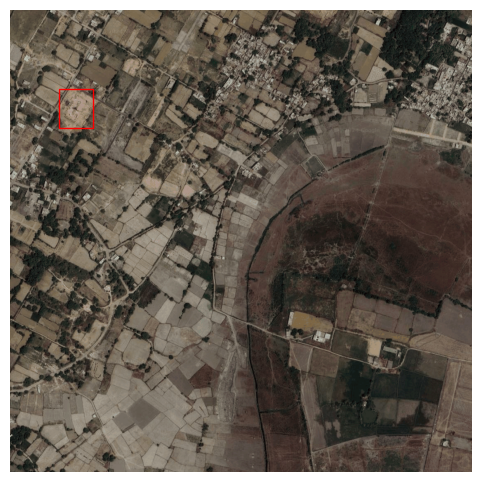

26.62,80.94.png


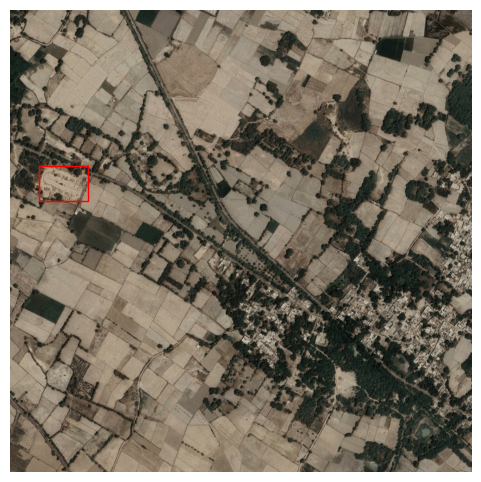

26.85,81.23.png


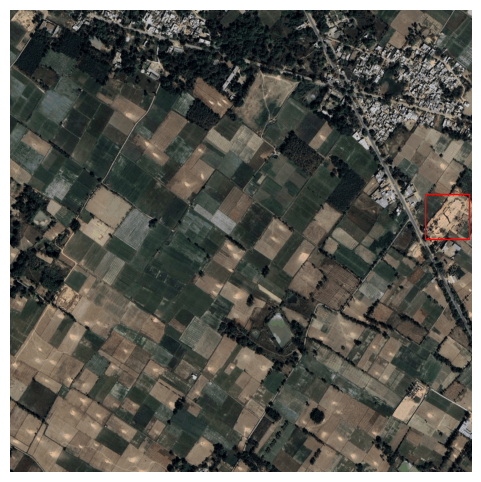

26.88,81.23.png


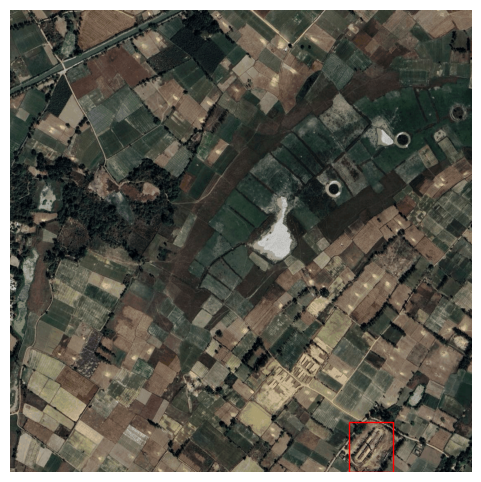

26.97,80.90.png


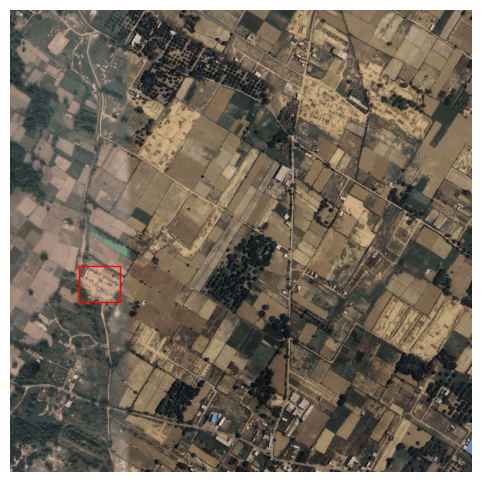

26.95,81.05.png


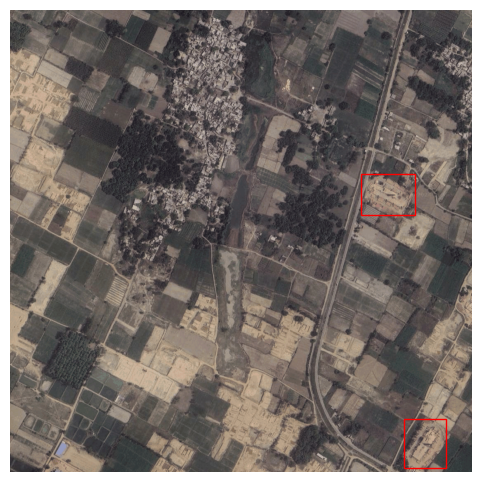

26.97,81.21.png


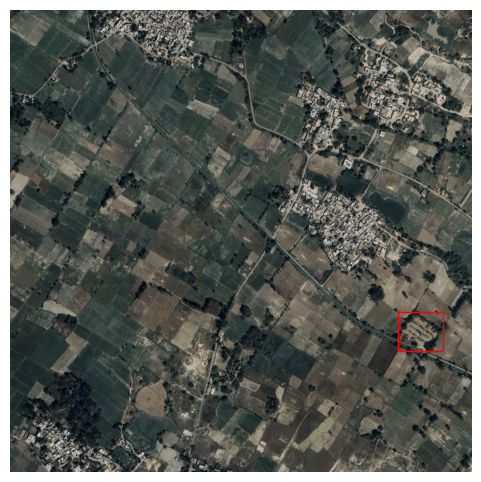

26.69,80.84.png


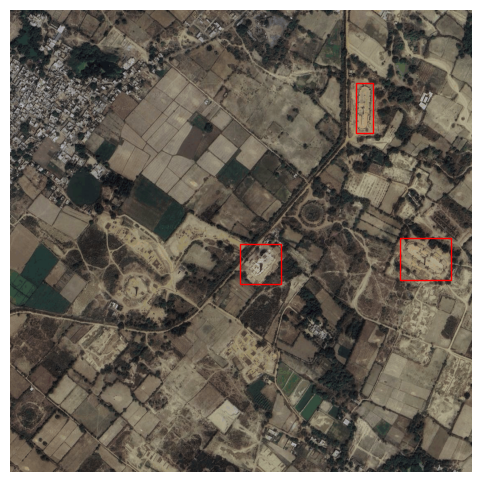

26.90,81.20.png


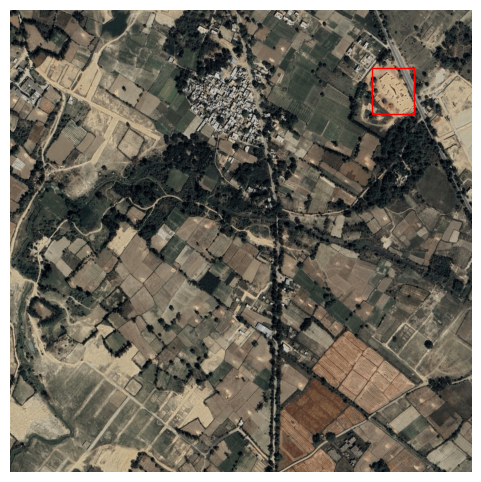

26.76,81.24.png


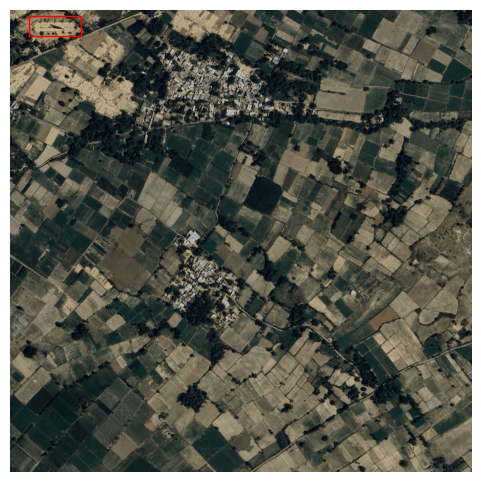

In [6]:
for file_name in first_ten_images:
    print(file_name)
    display_image(file_name, directory_path, directory_path_labels, save_path=save_path)

GMS With OBB 

26.71,80.96.png


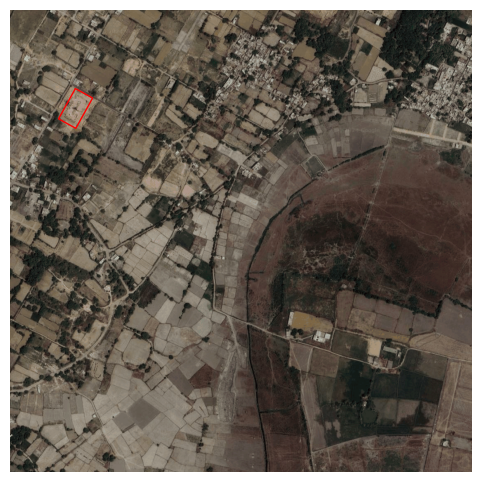

26.62,80.94.png


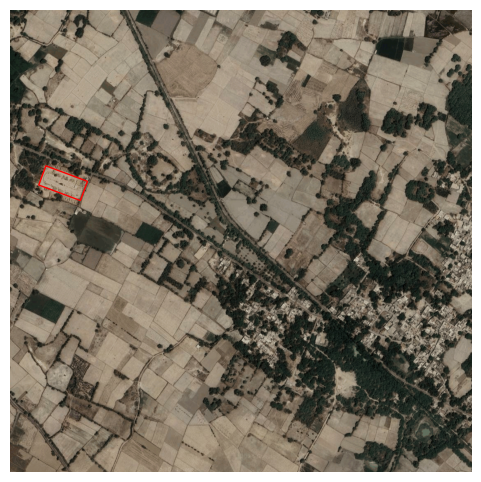

26.85,81.23.png


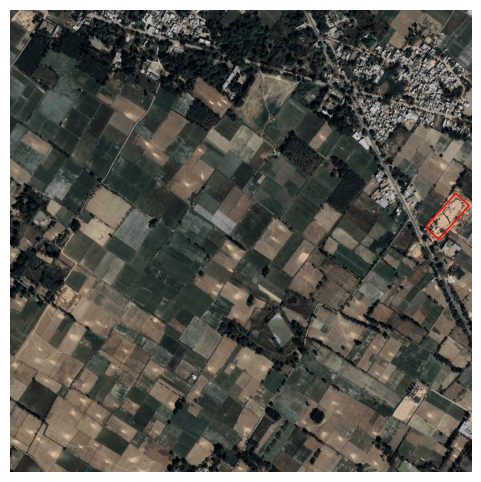

26.88,81.23.png


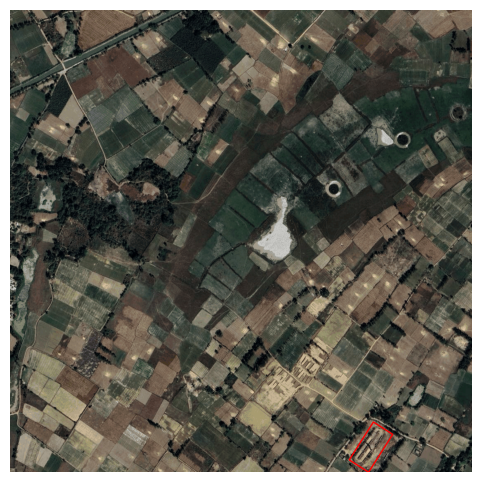

26.97,80.90.png


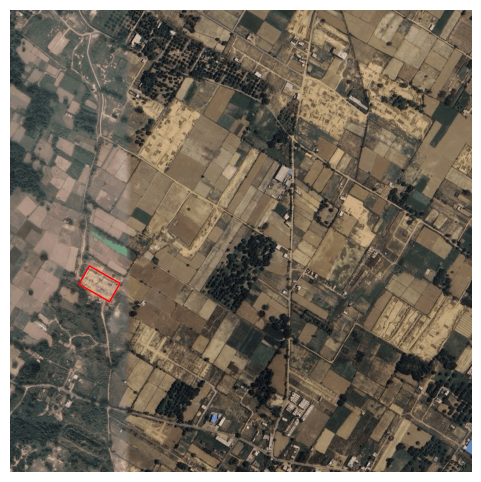

26.95,81.05.png


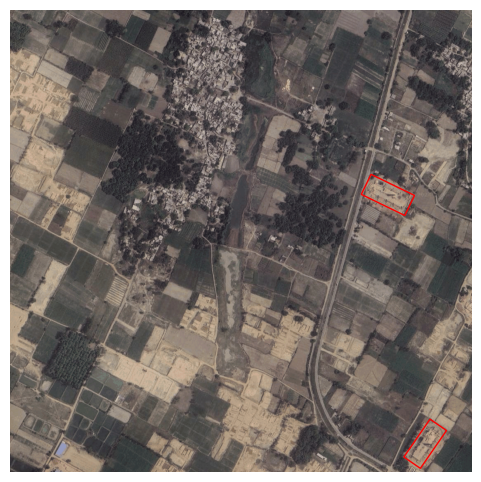

26.97,81.21.png


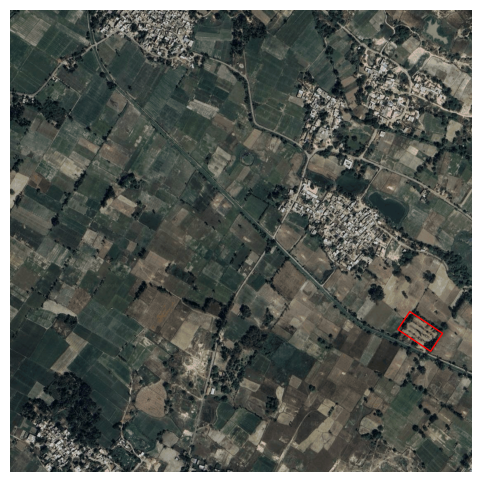

26.69,80.84.png


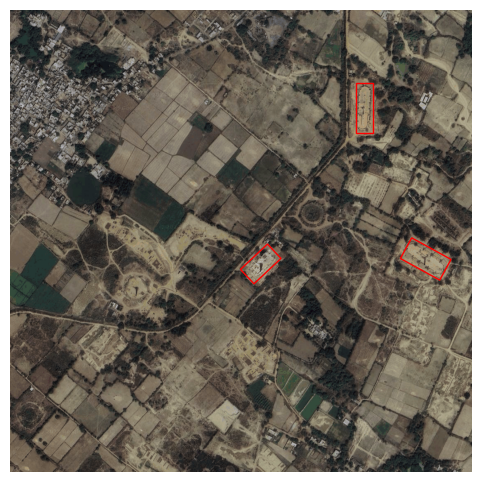

26.90,81.20.png


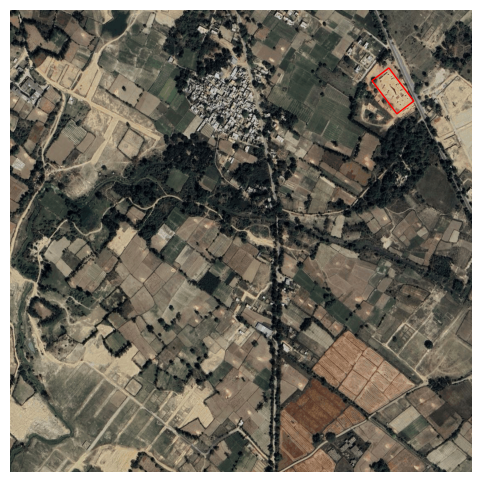

26.76,81.24.png


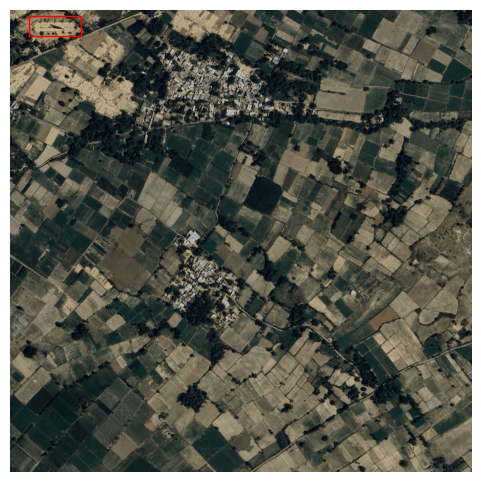

In [5]:
for file_name in first_ten_images:
    print(file_name)
    display_image(file_name, directory_path_obb, directory_path_labels_obb, save_path=save_path, obb=True)

GMS without bounding box

26.71,80.96.png


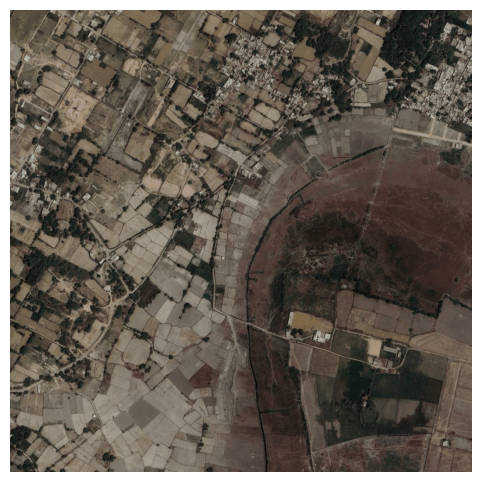

26.62,80.94.png


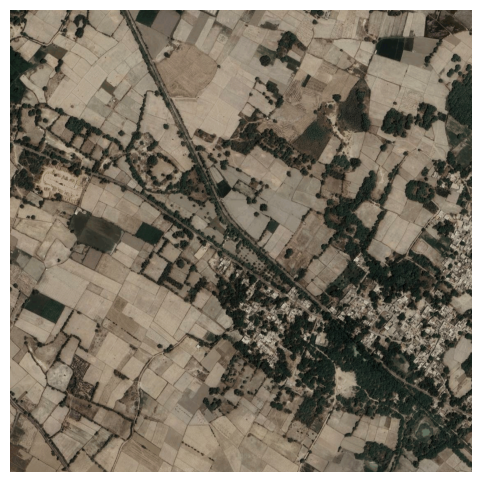

26.85,81.23.png


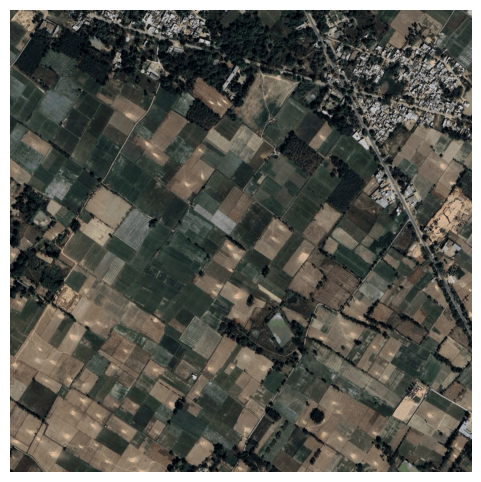

26.88,81.23.png


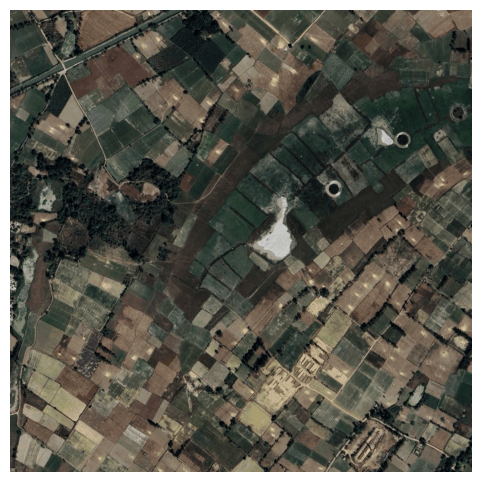

26.97,80.90.png


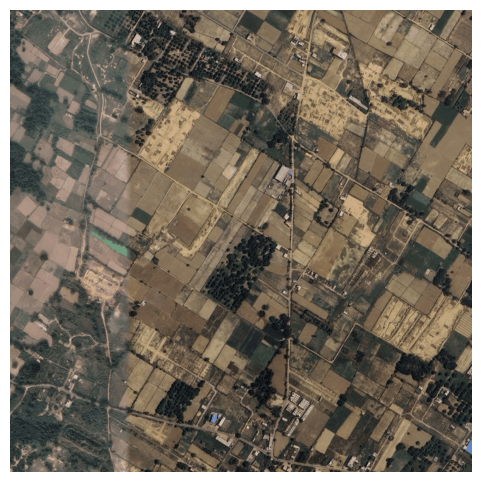

26.95,81.05.png


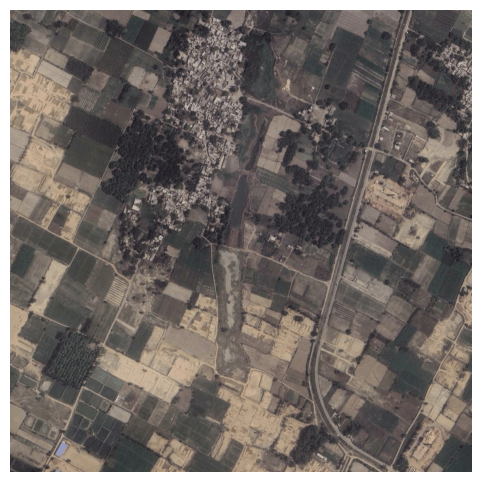

26.97,81.21.png


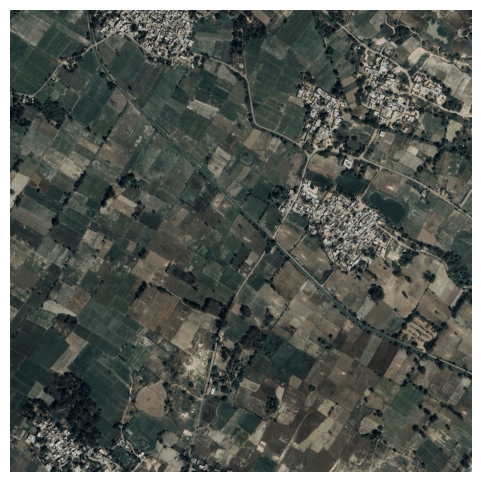

26.69,80.84.png


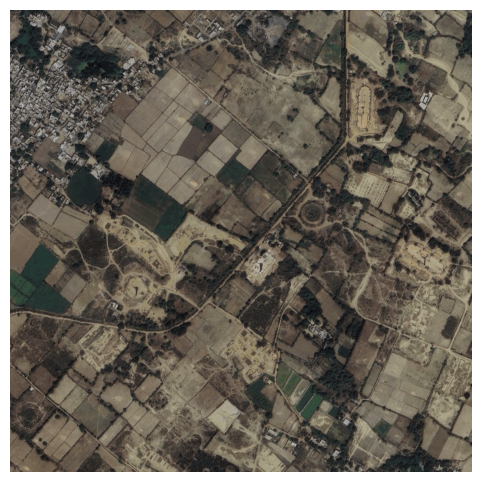

26.90,81.20.png


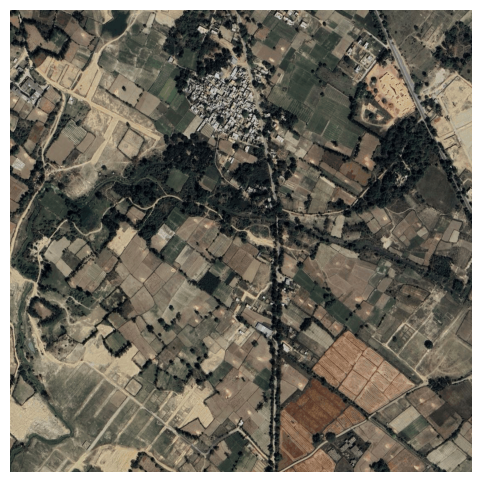

26.76,81.24.png


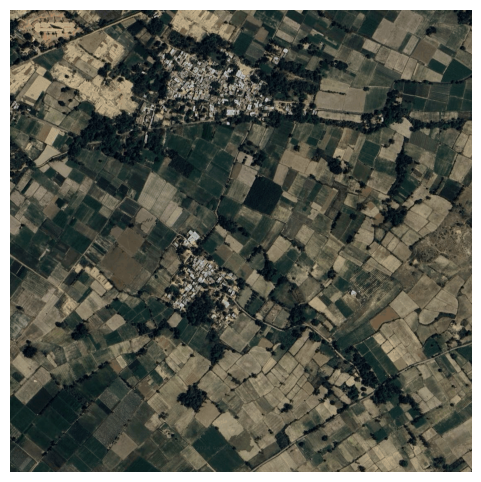

In [7]:
for file_name in first_ten_images:
    print(file_name)
    display_image(file_name, directory_path, directory_path_labels=None, save_path=save_path)

Sentinel with AA bounding box

26.71,80.96.png


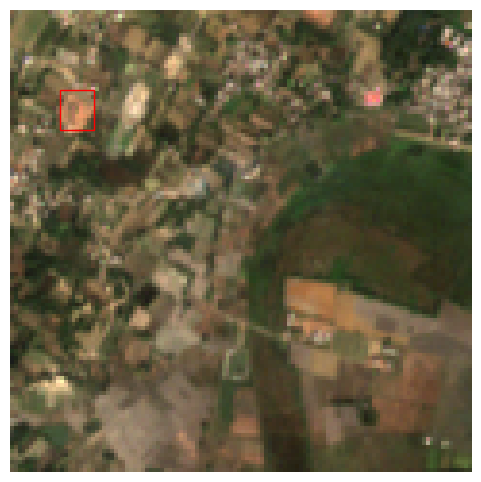

26.62,80.94.png


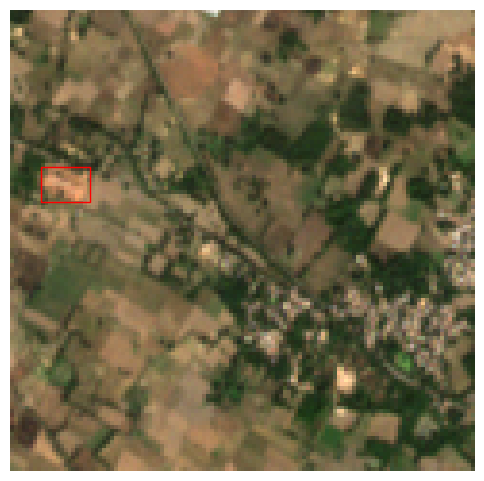

26.85,81.23.png


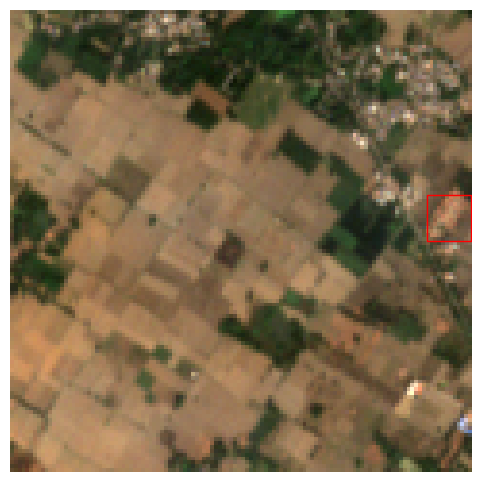

26.88,81.23.png


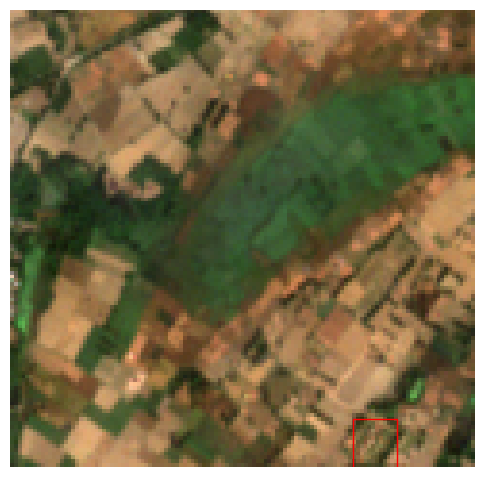

26.97,80.90.png


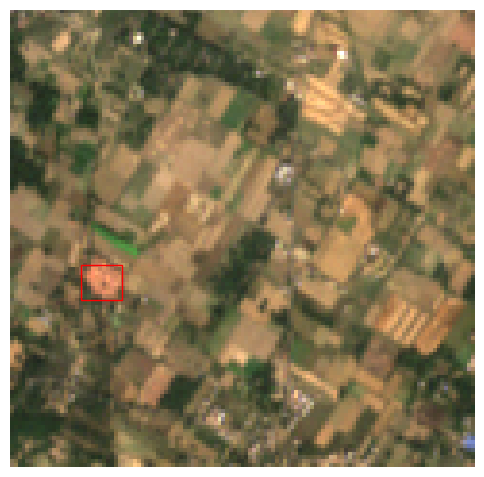

26.95,81.05.png


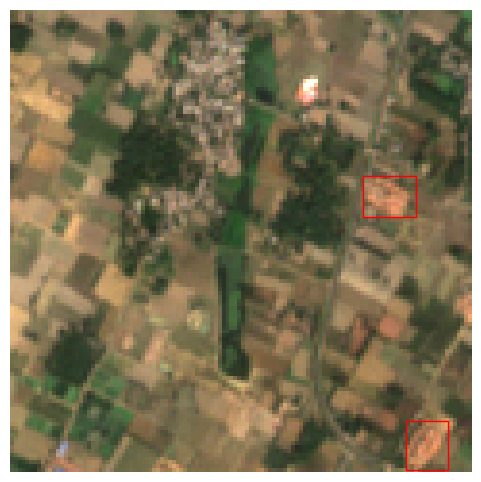

26.97,81.21.png


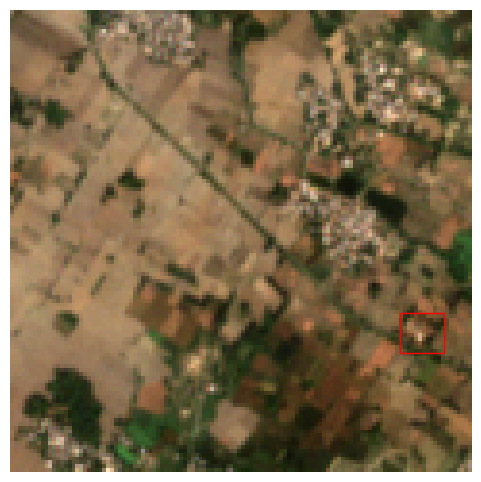

26.69,80.84.png


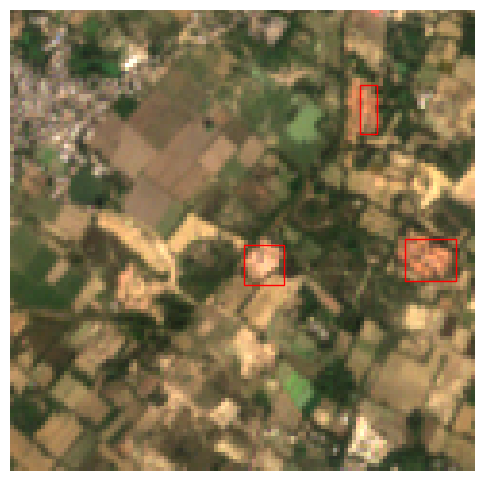

26.90,81.20.png


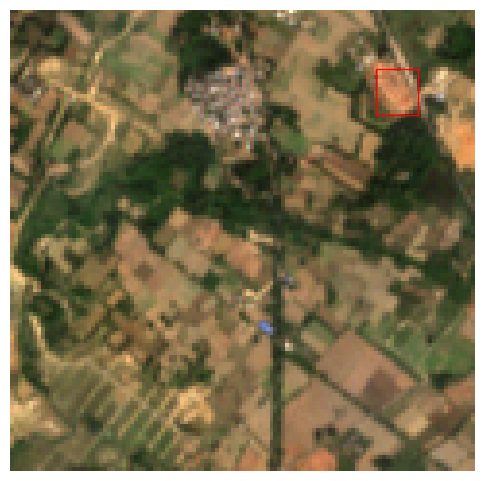

26.76,81.24.png


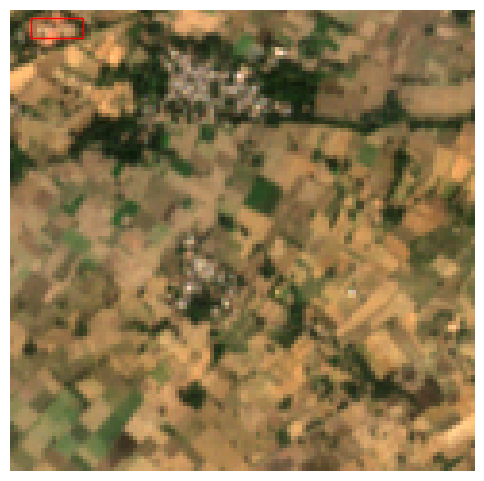

In [13]:
for file_name in first_ten_images:
    print(file_name)
    display_image(file_name, directory_path_sentinel, directory_path_labels, save_path=save_path, sentinel=True)

Sentinel with OBB

26.71,80.96.png


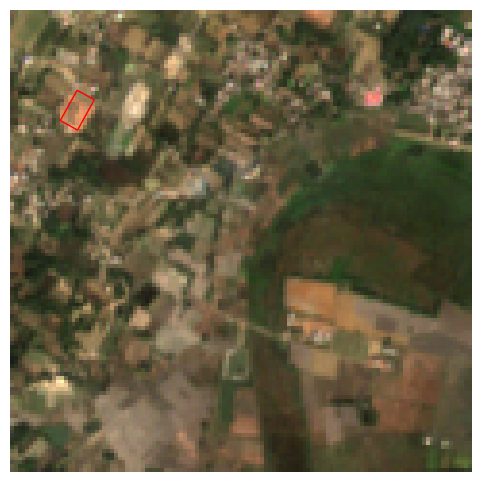

26.62,80.94.png


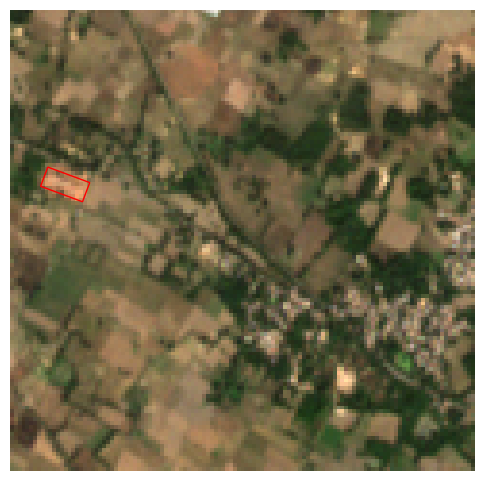

26.85,81.23.png


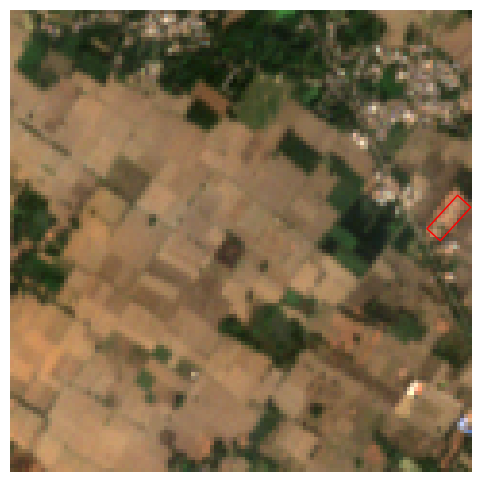

26.88,81.23.png


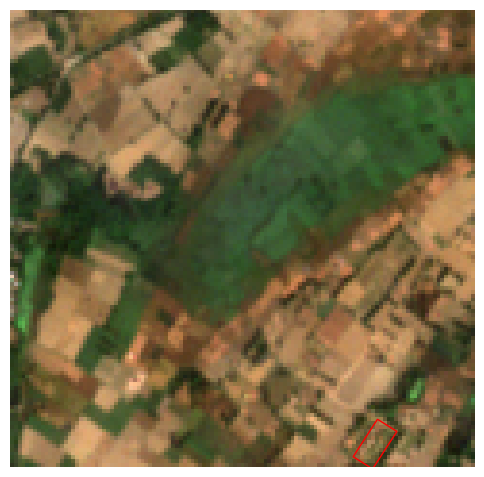

26.97,80.90.png


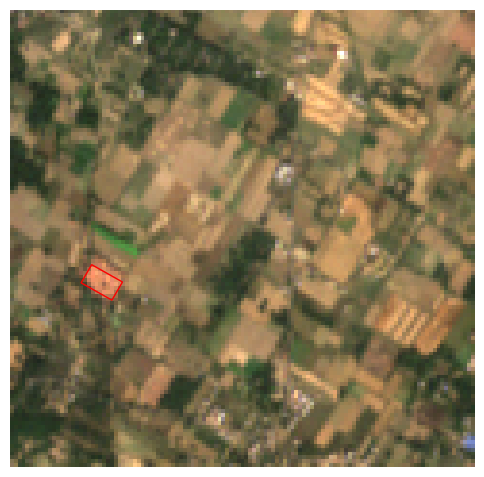

26.95,81.05.png


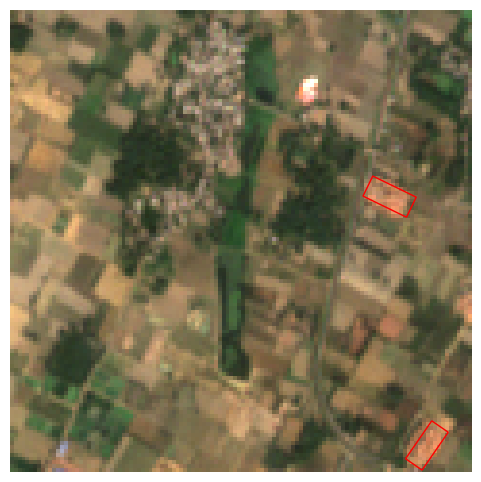

26.97,81.21.png


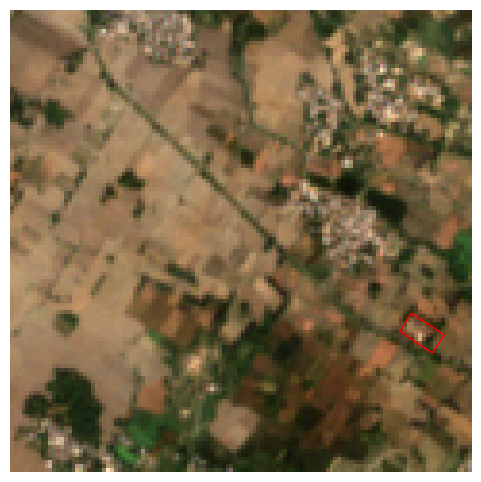

26.69,80.84.png


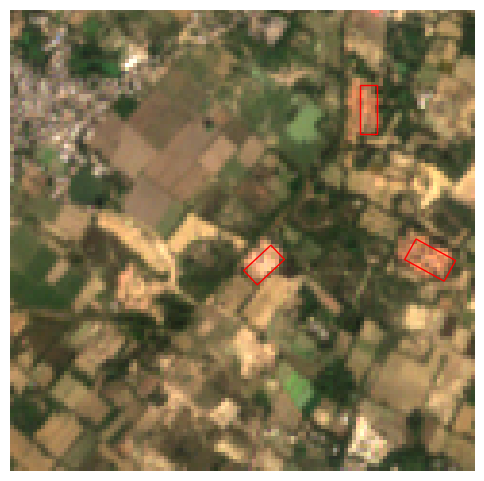

26.90,81.20.png


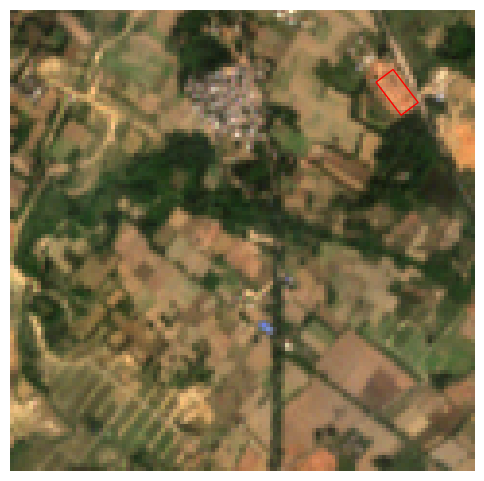

26.76,81.24.png


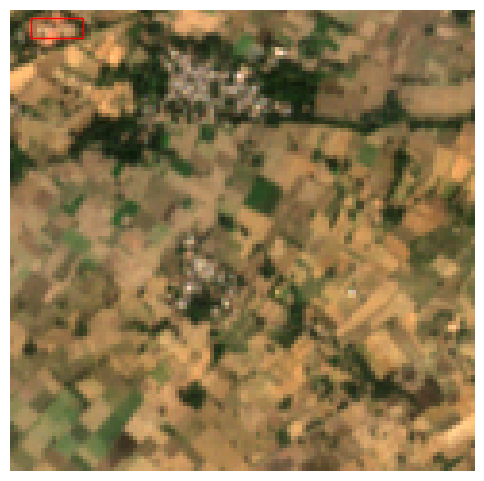

In [11]:
for file_name in first_ten_images:
    print(file_name)
    display_image(file_name, directory_path_sentinel_obb, directory_path_labels_obb, save_path=save_path, sentinel=True, obb=True)

Sentinel without bounding box

26.71,80.96.png


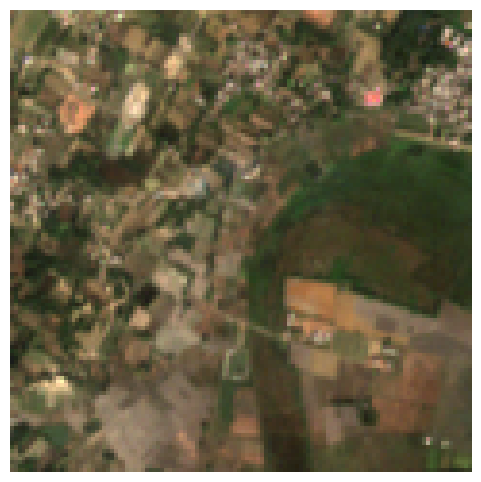

26.62,80.94.png


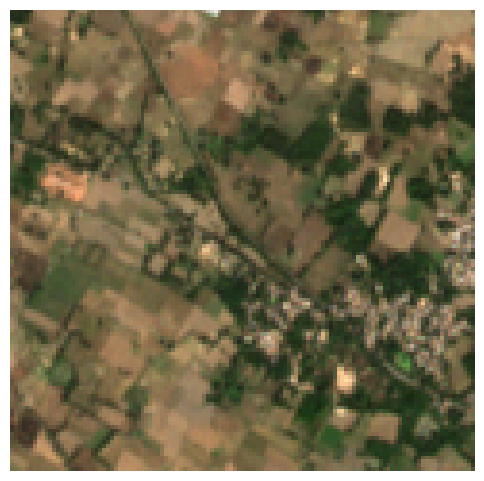

26.85,81.23.png


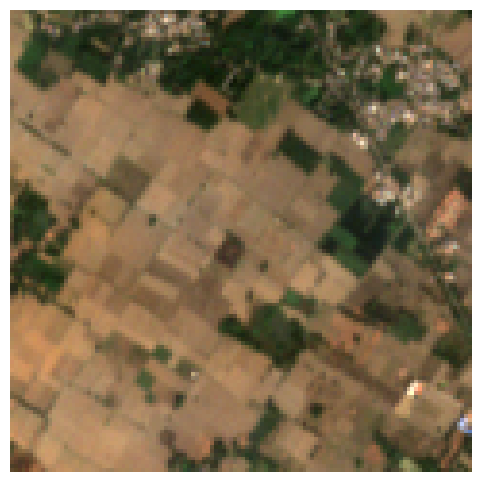

26.88,81.23.png


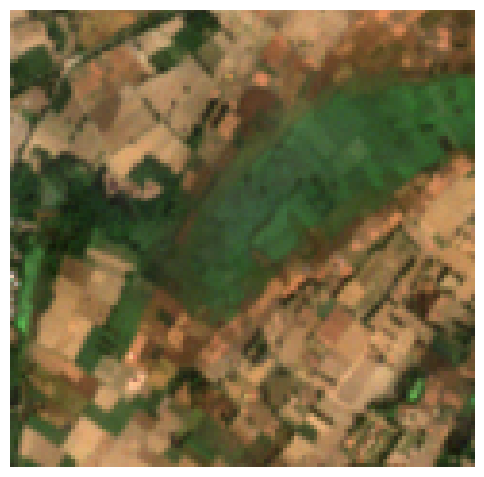

26.97,80.90.png


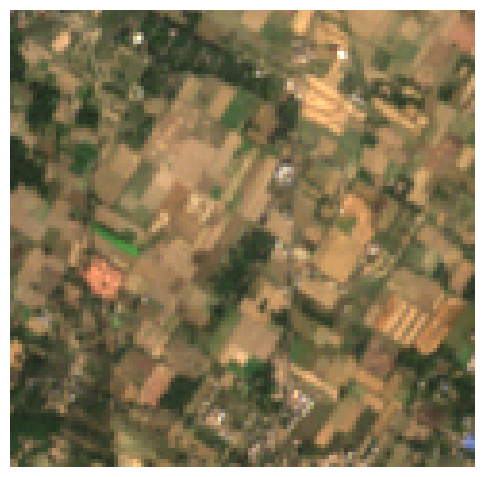

26.95,81.05.png


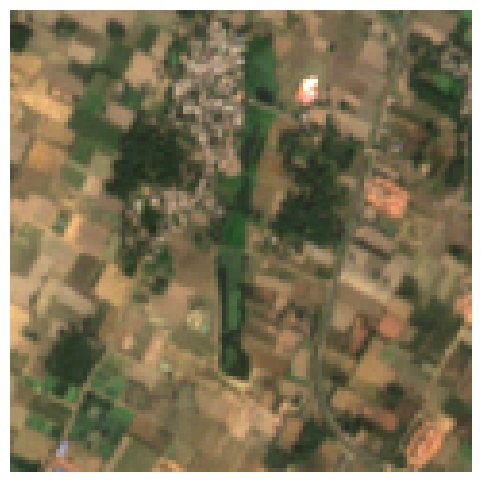

26.97,81.21.png


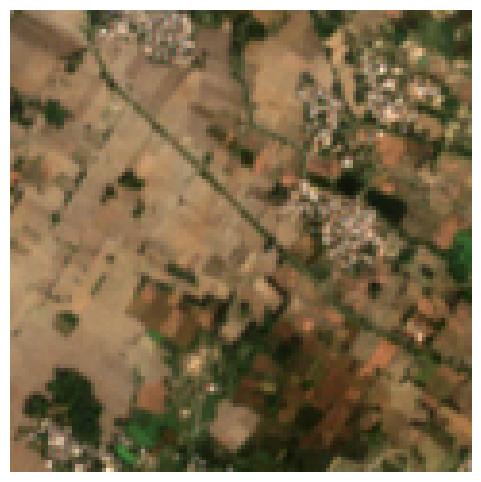

26.69,80.84.png


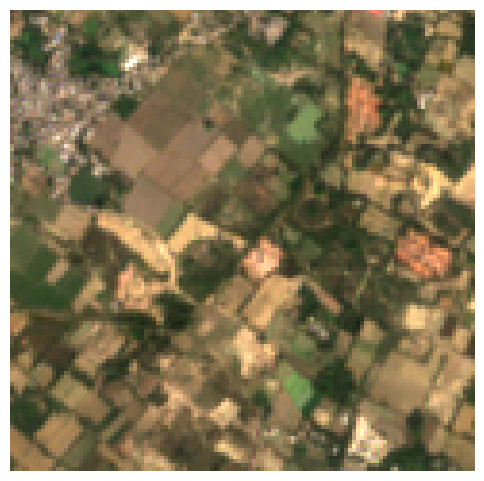

26.90,81.20.png


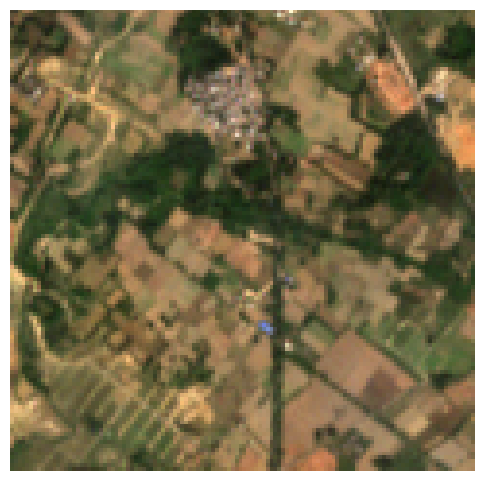

26.76,81.24.png


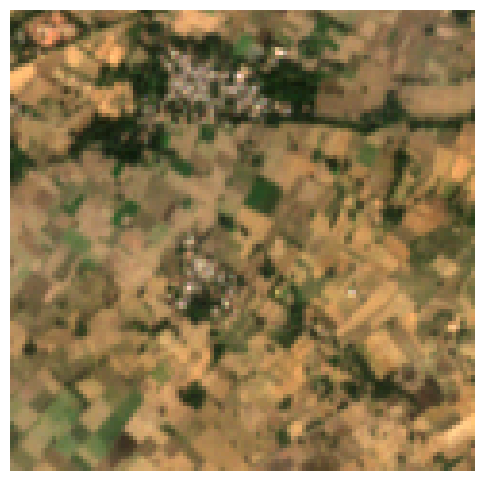

In [12]:
for file_name in first_ten_images:
    print(file_name)
    display_image(file_name, directory_path_sentinel, directory_path_labels=None, save_path=save_path, sentinel=True)